In [1]:
'''
author: Yike Xie
data: 02/12/2022
content: correlate hyperspectral imaging features and transcriptome
'''

'\nauthor: Yike Xie\ndata: 02/12/2022\ncontent: correlate hyperspectral imaging features and transcriptome\n'

In [3]:
import os
import sys
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns

import scanpy as sc
import pickle

In [ ]:
feas_fn = '/home/yike/phd/cancer_cells_img_seq/data/Abbas_features/YiKe.xlsx'
data_fn = '/home/yike/phd/cancer_cells_img_seq/data/20220201_NextSeq/gene_filter.h5ad'
adata_s = sg_dataset(feas_fn, data_fn)

In [ ]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [17]:
def sg_dataset(feas_fn, data_fn):
    
    print('load features')
    df = pd.read_excel(feas_fn, index_col=0)
    df.index = [i.split('-')[-1] for i in np.array(df.index.str.split('.').tolist())[:, 0]]

    print('load dataset')
    adata = sc.read_h5ad(data_fn)
    sc.pp.normalize_total(adata, target_sum=1e6)

    print('filter adata of single cells')
    adata_s = adata[adata.obs_names.isin(df.index)]

    print('filter genes')
    sc.pp.filter_genes(adata_s, min_cells=10)

    print('Add features to adata')
    adata_s.obs = pd.concat([adata_s.obs, df.loc[adata_s.obs_names]], axis=1)
        
    return adata_s

def get_correlation(adata_s, feas):
    #corr = dsim.correlation.correlate_features_phenotypes(feas, fillna=0)##
    exp = adata_s.X.T
    phe = adata_s.obs[feas].fillna(0)

    x = exp #(39466, 10)
    y = phe.values.T #(2, 10)

    from scipy.stats import rankdata

    xw = np.zeros_like(x, float)
    for ii, xi in enumerate(x):
        xw[ii] = rankdata(xi, method='average')
    yw = np.zeros_like(y, float)
    for ii, yi in enumerate(y):
        yw[ii] = rankdata(yi, method='average')

    xw = ((xw.T - xw.mean(axis=1)) / xw.std(axis=1)).T
    yw = ((yw.T - yw.mean(axis=1)) / yw.std(axis=1)).T
    n = xw.shape[1]
    r = np.dot(xw, yw.T) / n

    corr = pd.DataFrame(
                    data=r,
                    index=adata_s.var_names,
                    columns=phe.columns,
                    dtype=float)

    return corr

def plot_correlation(genes, adata_s, fea, xlabel, path, filetype=False):
    '''
    genes = {
    'positive': [],
    'negative': []
    }
    '''
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    
    import itertools
    n_genes = len(list(itertools.chain.from_iterable(genes.values())))
    colors = sns.color_palette('tab10', n_genes)
    colors = [colors[: len(genes['positive'])], colors[len(genes['positive']):]]

    fig, axs = plt.subplots(2, 1, figsize=(4, 6), dpi=300)

    
    for j, (ax, genes) in enumerate(zip(axs, [genes['positive'], genes['negative']])):
        for ig, gene in enumerate(genes):
            x = adata_s.obs[fea]
            y = adata_s[:, gene].X + 0.1
            idx = np.argsort(x)
            ax.scatter(
                x[idx], y[idx], alpha=0.8, label=gene, lw=2, color=colors[j][ig], s=10, 
            )
        ax.legend(fontsize=8, bbox_to_anchor=(1, 1))
        ax.set_xlabel(xlabel)
        ax.set_ylabel('Gene exp [cpm]')
        ax.set_yscale('log')
#         ax.set_xscale('log')

    axs[0].set_title('Positive correlation')
    axs[1].set_title('Negative correlation')
    fig.tight_layout()

    if filetype is not False:
        plt.savefig(save_figures + fea + filetype)
    
    return {'fig': fig, 'axs': axs}

In [18]:
feas_fn = '/home/yike/phd/cancer_cells_img_seq/data/Abbas_features/YiKe.xlsx'
data_fn = '/home/yike/phd/cancer_cells_img_seq/data/20220201_NextSeq/gene_filter.h5ad'
adata_s = sg_dataset(feas_fn, data_fn)

save_figures = '/home/yike/phd/cancer_cells_img_seq/figures/hyperspectral_images/hyperspectral_features/'

load features


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


load dataset
filter adata of single cells
filter genes


/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.var` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Add features to adata


In [19]:
print('Correlate with some simple features')
feas = adata_s.obs.columns[8:]

# corr = get_correlation(adata_s, feas)
# corr.to_csv(save_figures + 'correlation.tsv', sep='\t')

# corr = corr[4:]

Correlate with some simple features


/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

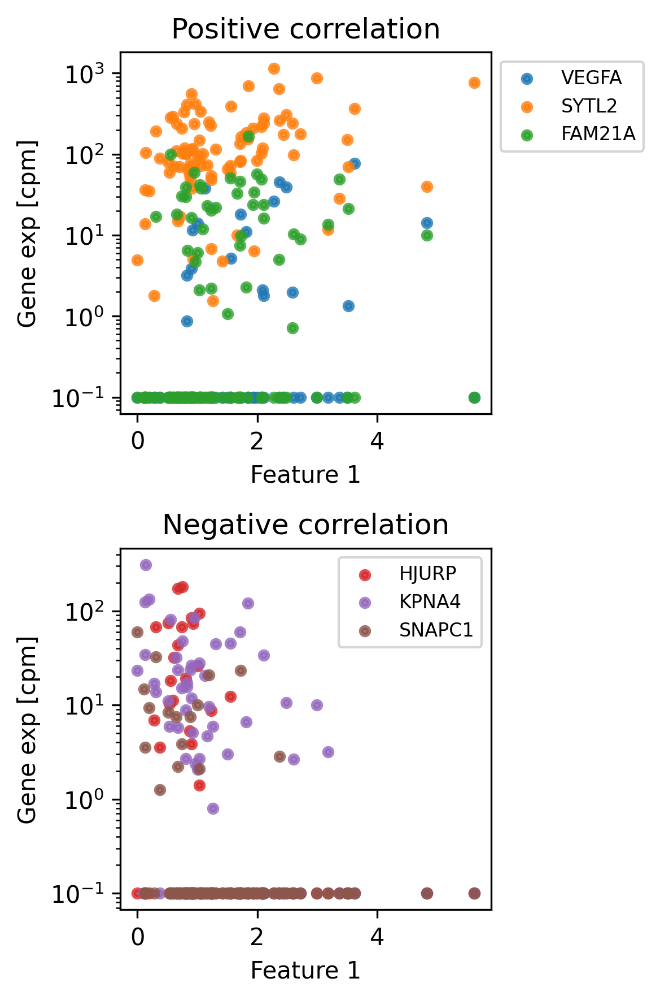

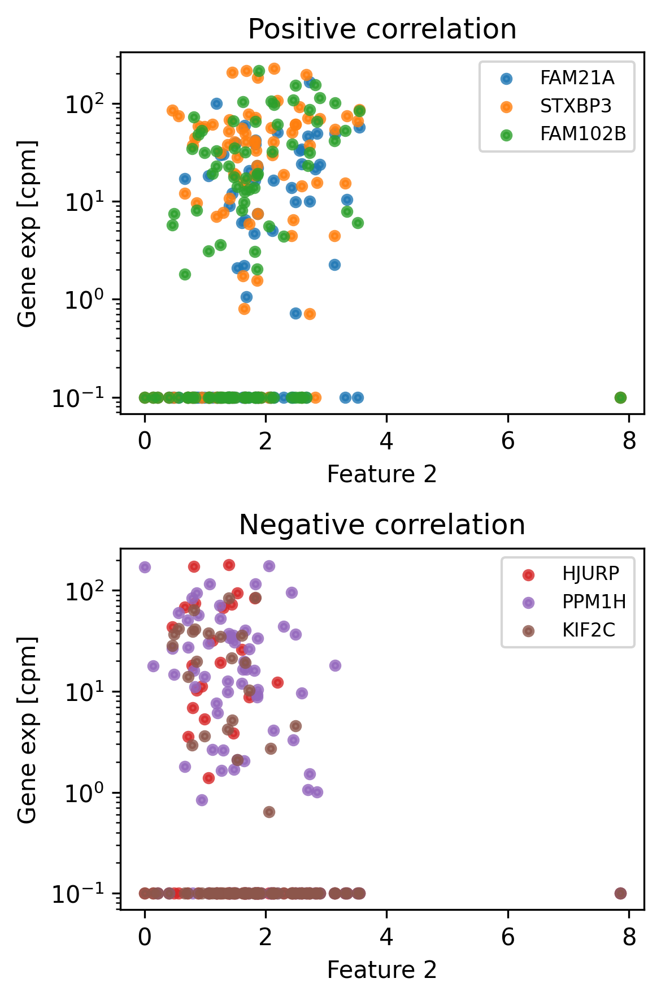

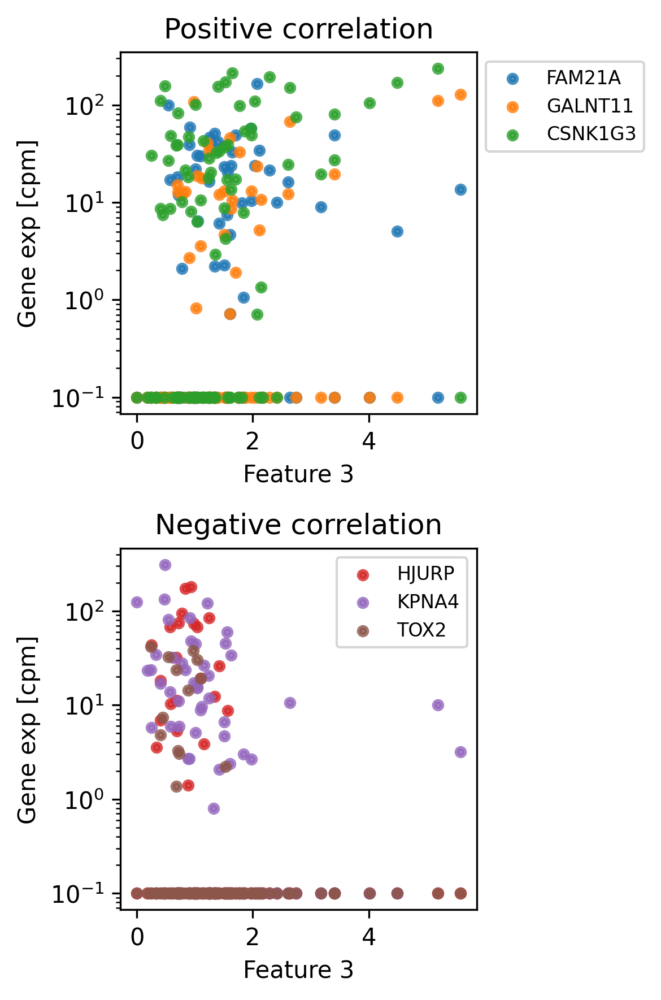

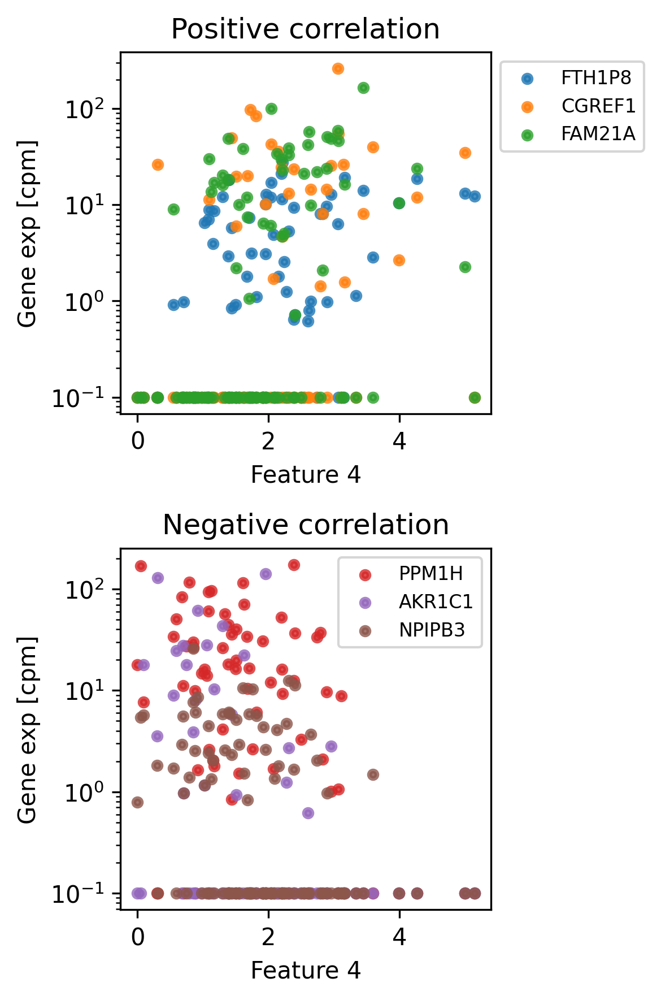

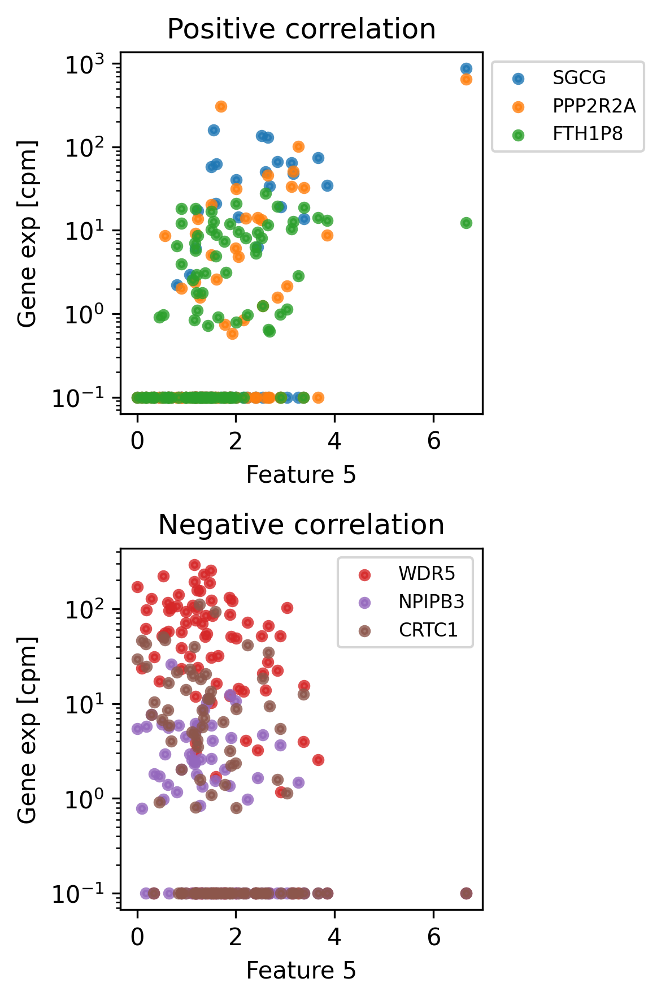

...

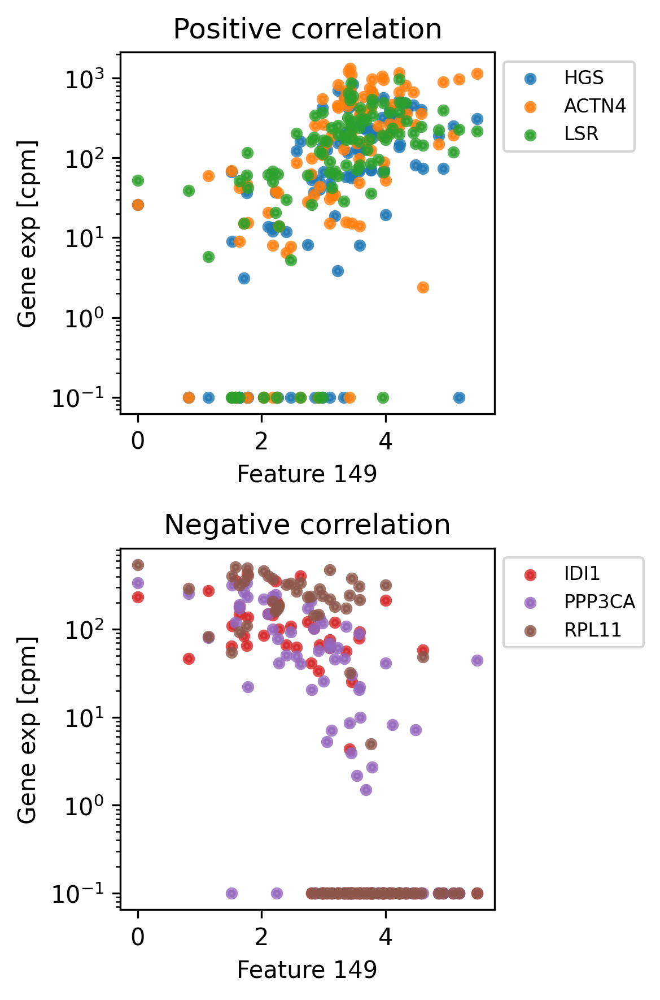

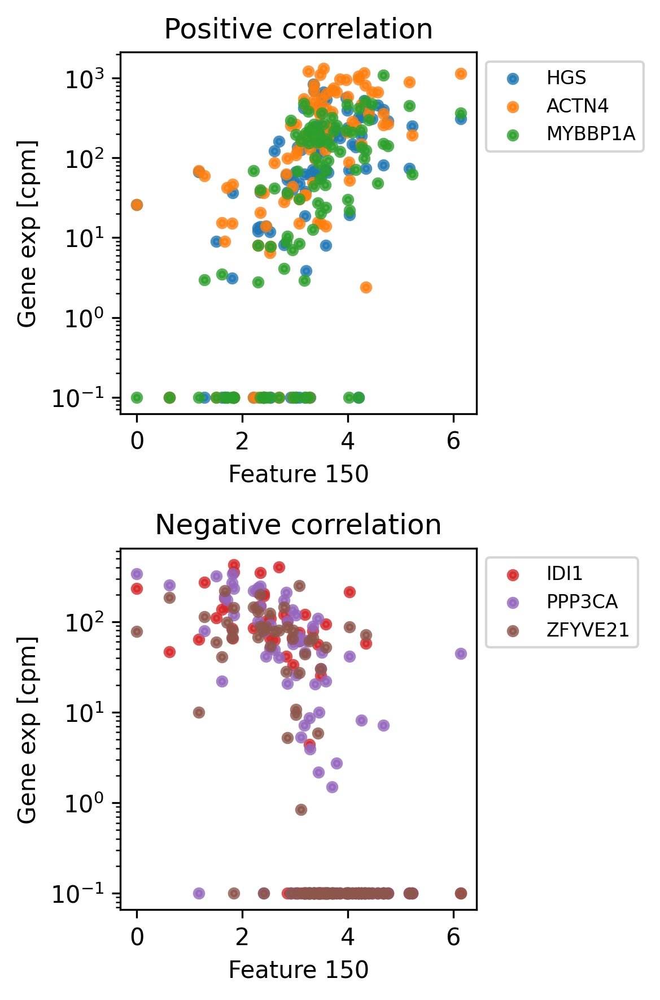

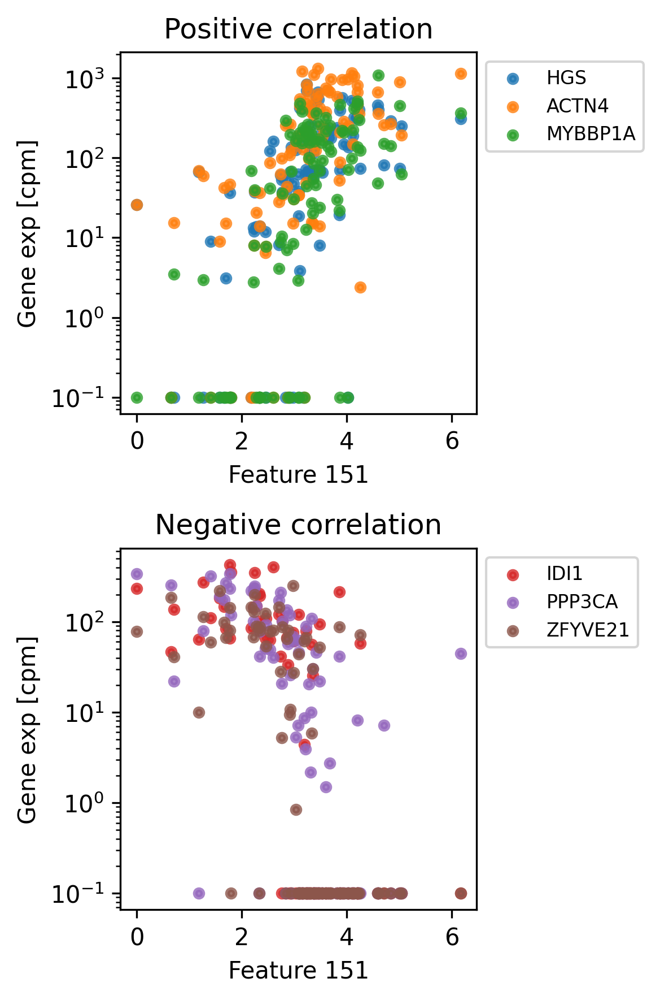

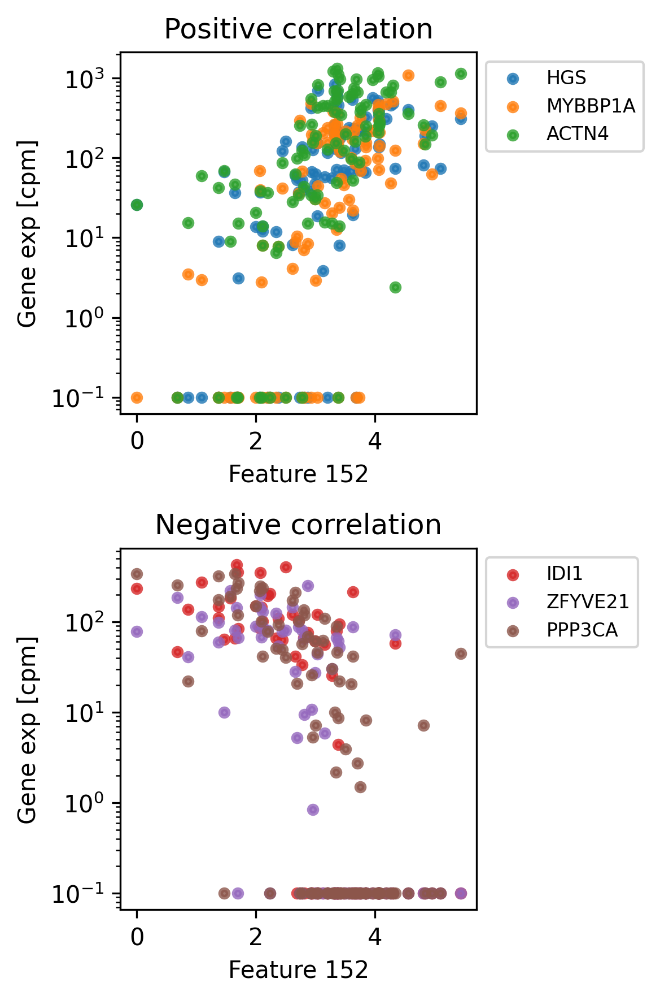

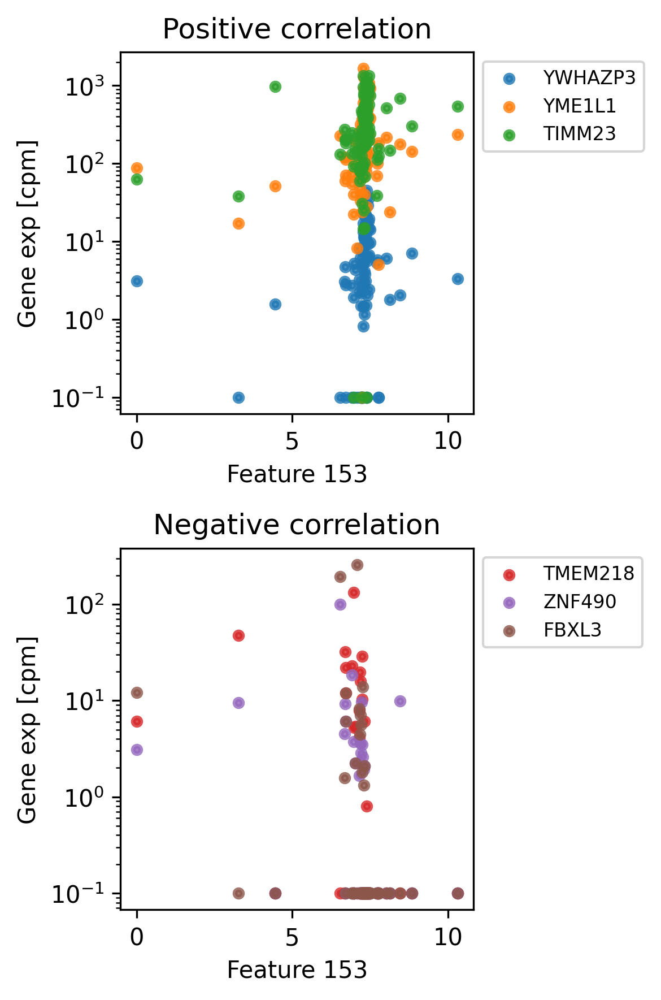

In [128]:
feas = adata_s.obs.columns[8:]
xlabels = adata_s.obs.columns[8:]

for fea, xlabel in zip(feas, xlabels):

    path = save_figures
    filetype = '.png' 
    genes = {
        'positive': corr.nlargest(3, fea).index.tolist(),
        'negative': corr.nsmallest(3, fea).index.tolist(),
    }
    plot_correlation(genes, adata_s, fea, xlabel, path, filetype='.png')

In [147]:
# filter features
# average of top 10 positive and negative features

pos = []
neg = []
for fea in corr.columns:
    mi =  corr[fea].sort_values()[-10:].mean()
    ma =  corr[fea].sort_values()[:10].mean()
    
    pos.append(mi)
    neg.append(ma)
    

In [152]:
corr.loc['pos'] = pos
corr.loc['neg'] = neg

In [151]:
corr.loc['pos'].sort_values()[-15:]

Feature 76     0.584173
Feature 142    0.585894
Feature 143    0.589407
Feature 74     0.590178
Feature 17     0.590178
Feature 25     0.590738
Feature 75     0.590738
Feature 146    0.594074
Feature 148    0.600091
Feature 9      0.604206
Feature 147    0.607876
Feature 149    0.614029
Feature 150    0.640046
Feature 152    0.640852
Feature 151    0.643731
Name: mins, dtype: float64

In [154]:
corr.loc['neg'].sort_values()[:15]

Feature 152   -0.694248
Feature 151   -0.687024
Feature 150   -0.685329
Feature 149   -0.677667
Feature 148   -0.665414
Feature 143   -0.664785
Feature 142   -0.663082
Feature 147   -0.660451
Feature 9     -0.658067
Feature 144   -0.654828
Feature 146   -0.650975
Feature 17    -0.642772
Feature 74    -0.642772
Feature 76    -0.639791
Feature 33    -0.639791
Name: neg, dtype: float64

In [5]:
corr = pd.read_csv(save_figures + 'correlation.tsv', sep='\t')

corr = corr[4:]

In [11]:
nmax = []
for col in corr.columns[1:]:
    nmax.append(max(corr[col].sort_values()))

In [15]:
pd.Series(nmax, corr.columns[1:]).sort_values()[-50:]

Feature 32     0.464693
Feature 68     0.464693
Feature 89     0.467073
Feature 59     0.470137
Feature 23     0.470137
Feature 139    0.480041
Feature 111    0.483973
Feature 112    0.484845
Feature 140    0.490678
Feature 136    0.497612
Feature 107    0.498119
Feature 115    0.498445
Feature 114    0.501698
Feature 105    0.503137
Feature 123    0.508109
Feature 122    0.510148
Feature 8      0.511891
Feature 131    0.512997
Feature 106    0.528858
Feature 81     0.532994
Feature 73     0.532994
Feature 128    0.535238
Feature 120    0.537451
Feature 141    0.541961
Feature 130    0.544823
Feature 57     0.590455
Feature 79     0.590455
Feature 49     0.590530
Feature 78     0.590530
Feature 80     0.596861
Feature 65     0.596861
Feature 77     0.599006
Feature 41     0.599006
Feature 144    0.611264
Feature 76     0.615714
Feature 33     0.615714
Feature 146    0.620083
Feature 25     0.624970
Feature 75     0.624970
Feature 17     0.625866
Feature 74     0.625866
Feature 9      0

In [ ]:
# filter feature with correlation > 0.6 or < -0.6

In [14]:
corr['Feature 151'].sort_values()

625    -0.713263
4576   -0.699965
1484   -0.696934
4862   -0.690886
2477   -0.685178
          ...   
1151    0.632051
1953    0.648722
3915    0.656857
3736    0.684994
8233    0.694883
Name: Feature 151, Length: 10365, dtype: float64

In [37]:
corr[['Feature 151', 'gene_name']].sort_values('Feature 151')

,Feature 151,gene_name
625,-0.713263,IDI1
4576,-0.699965,PPP3CA
1484,-0.696934,ZFYVE21
4862,-0.690886,RPL11
2477,-0.685178,C6orf62
...,...,...
1151,0.632051,PXN
1953,0.648722,LSR
3915,0.656857,MYBBP1A
3736,0.684994,ACTN4


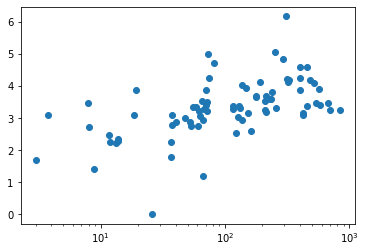

In [39]:
fig, ax = plt.subplots()
ax.scatter(adata_s[:, 'HGS'].X.mean(axis=1), adata_s.obs['Feature 151'])
ax.set_xscale('log')

In [40]:
from scipy.stats import pearsonr

In [47]:
pearsonr(np.log10(np.array(adata_s[:, 'HGS'].X.mean(axis=1) + 0.1)), adata_s.obs['Feature 151'])

(0.5860693986077453, 3.5379111369864397e-10)

In [ ]:
# spread
# regression, goodnedd of fit
# R2
# 